In [1]:
using Revise

In [ ]:
using
    QuantumStates,
    OpticalBlochEquations,
    DifferentialEquations,
    UnitsToValue,
    LinearAlgebra,
    Printf,
    Plots,
    # DiffEqNoiseProcess,
    Random,
    StatsBase
;

using Distributions

import MutableNamedTuples: MutableNamedTuple
import StructArrays: StructArray, StructVector
import StaticArrays: @SVector, SVector
import LinearAlgebra: norm, ⋅, adjoint!, diag
import LoopVectorization: @turbo
using BenchmarkTools
using Parameters
using LsqFit

import ProgressMeter: Progress, next!

const λ = 626e-9
const Γ = 2π* 6.4e6
const m = @with_unit 57 "u"
const k = 2π / λ
_μB = (μ_B / h) * 1e-4;

[ Info: Precompiling OpticalBlochEquations [691d0331-80d3-41b1-b293-7891a6f4a14f]


### Hamiltonian for CaOH

In [4]:
QN_bounds = (
    S = 1/2, 
    I = 1/2, 
    Λ = 0, 
    N = 0:3
)
X_state_basis = enumerate_states(HundsCaseB_Rot, QN_bounds)

X_state_operator = :(
    BX * Rotation + 
    DX * RotationDistortion + 
    γX * SpinRotation + 
    bFX * Hyperfine_IS + 
    cX * (Hyperfine_Dipolar/3)
)

X_state_parameters = QuantumStates.@params begin
    BX = 10023.0841
    DX = 1.154e-2
    γX = 34.7593
    bFX = 2.602
    cX = 2.053
end

X_state_ham = Hamiltonian(basis=X_state_basis, operator=X_state_operator, parameters=X_state_parameters)

# Add Zeeman terms
Zeeman_x(state, state′) = (Zeeman(state, state′,-1) - Zeeman(state, state′,1))/sqrt(2)
Zeeman_y(state, state′) = im*(Zeeman(state, state′,-1) + Zeeman(state, state′,1))/sqrt(2)
Zeeman_z(state, state′) = Zeeman(state, state′, 0)

X_state_ham = add_to_H(X_state_ham, :B_x, (gS * _μB * 1e-6) * Zeeman_x)
X_state_ham = add_to_H(X_state_ham, :B_y, (gS * _μB * 1e-6) * Zeeman_y)
X_state_ham = add_to_H(X_state_ham, :B_z, (gS * _μB * 1e-6) * Zeeman_z)
X_state_ham.parameters.B_x = 0.
X_state_ham.parameters.B_y = 0.
X_state_ham.parameters.B_z = 0.

evaluate!(X_state_ham)
QuantumStates.solve!(X_state_ham)
;

QN_bounds = (
    S = 1/2,
    I = 1/2,
    Λ = (-1,1),
    J = 1/2:5/2
)
A_state_basis = enumerate_states(HundsCaseA_Rot, QN_bounds)

A_state_operator = :(
    T_A * DiagonalOperator +
    Be_A * Rotation + 
    Aso_A * SpinOrbit +
    q_A * ΛDoubling_q +
    p_A * ΛDoubling_p2q + q_A * (2ΛDoubling_p2q)
)

# Spectroscopic constants for CaOH, A state
A_state_parameters = QuantumStates.@params begin
    T_A = 15998.122 * 299792458 * 1e-4
    Be_A = 0.3412200 * 299792458 * 1e-4
    Aso_A = 66.8181 * 299792458 * 1e-4
    p_A = -0.04287 * 299792458 * 1e-4
    q_A = -0.3257e-3 * 299792458 * 1e-4
end

A_state_ham = Hamiltonian(basis=A_state_basis, operator=A_state_operator, parameters=A_state_parameters)
evaluate!(A_state_ham)
QuantumStates.solve!(A_state_ham)
;

A_state_J12_pos_parity_states = A_state_ham.states[5:8]

QN_bounds = (
    S = 1/2, 
    I = 1/2, 
    Λ = (-1,1), 
    N = 0:3
)
A_state_caseB_basis = enumerate_states(HundsCaseB_Rot, QN_bounds)

ground_states = X_state_ham.states[5:16]
excited_states = convert_basis(A_state_J12_pos_parity_states, A_state_caseB_basis)

states = [ground_states; excited_states]
n_excited = length(excited_states)

for state ∈ states
    state.E *= 1e6
end
;

d = zeros(ComplexF64, 16, 16, 3)
d_ge = zeros(ComplexF64, 12, 4, 3)

basis_tdms = get_tdms_two_bases(X_state_ham.basis, A_state_caseB_basis, TDM)
tdms_between_states!(d_ge, basis_tdms, ground_states, excited_states)
d[1:12, 13:16, :] .= d_ge
;

In [5]:
function update_H(H, p, r, τ)
    Zeeman_Hz = p.extra_p.Zeeman_Hz
    Zeeman_Hx = p.extra_p.Zeeman_Hx
    Zeeman_Hy = p.extra_p.Zeeman_Hy
    
    # ramp the magnetic field
    # τ_bfield = 5e-3 / (1/Γ)
    # scalar = 0.1 * exp(τ/τ_bfield)
    # scalar = min(scalar, 1.0)
    
    # make the magnetic field vary sinusoidally
    scalar = cos(RF_frequency * τ + π/2)
    
    gradient_z = scalar * p.extra_p.gradient_z
    gradient_x = scalar * p.extra_p.gradient_x
    gradient_y = scalar * p.extra_p.gradient_y
    @turbo for i in eachindex(H)
        H.re[i] = gradient_z * Zeeman_Hz.re[i] * r[3] + gradient_x * Zeeman_Hx.re[i] * r[1] + gradient_y * Zeeman_Hy.re[i] * r[2]
        H.im[i] = gradient_z * Zeeman_Hz.im[i] * r[3] + gradient_x * Zeeman_Hx.im[i] * r[1] + gradient_y * Zeeman_Hy.im[i] * r[2]
    end
    return nothing
end

function randomize_initial_vector!(p, r_dist, v_dist)
    n_excited = extra_p.n_excited
    n_states = length(p.states)
    p.ψ[n_states + n_excited + 1] = rand(r_dist)*k
    p.ψ[n_states + n_excited + 2] = rand(r_dist)*k
    p.ψ[n_states + n_excited + 3] = rand(r_dist)*k
    p.ψ[n_states + n_excited + 4] = rand(v_dist)*k/Γ
    p.ψ[n_states + n_excited + 5] = rand(v_dist)*k/Γ
    p.ψ[n_states + n_excited + 6] = rand(v_dist)*k/Γ
end
;

In [6]:
function operator_to_matrix(A, states)
    """
    Write an operator as a matrix in basis {states}.
    """
    n_states = length(states)
    A_mat = zeros(ComplexF64, n_states, n_states)
    for i in 1:n_states
        for j in 1:n_states
            A_mat[i,j] = extend_operator(A, states[i], states[j])
        end
    end
    return A_mat
end

function operator_to_matrix_zero_padding2(OA, A_states, B_states)
    """
    OA is an operator on Hilbert space A (basis = A_states).
    We would like to extend A to the direct-sum space A ⨁ B by padding with zeros, i.e.
    <i|OAB|j> = 0 if i∉A or j∉A, <i|OAB|j> = <i|OA|j> if i∈A and j∈A.
    """
    n_A = length(A_states)
    n_B = length(B_states)
    OAB_mat = zeros(ComplexF64, n_A+n_B, n_A+n_B)
    OAB_mat[1:n_A, 1:n_A] .= operator_to_matrix(OA, A_states)
    return OAB_mat
end
;

In [7]:
function init_isotropic_MOT_distribution(T, diameter)
    kB = 1.381e-23
    m = @with_unit 57 "u"
    σ = sqrt(kB * T / m)
    
    r = Normal(0, diameter)
    v = Normal(0, σ)
    return r, v
end

function init_MOT_distribution(T, diameter,displacement,kick)
    kB = 1.381e-23
    m = @with_unit 57 "u"
    σ = sqrt(kB * T / m)
    
    r = Normal(displacement, diameter)
    v = Normal(kick, σ)
    return r, v
end

function randomize_initial_vector!(p, x_dist, y_dist, z_dist, vx_dist, vy_dist, vz_dist)
    n_excited = extra_p.n_excited
    n_states = length(p.states)
    p.ψ[n_states + n_excited + 1] = rand(x_dist)*k
    p.ψ[n_states + n_excited + 2] = rand(y_dist)*k
    p.ψ[n_states + n_excited + 3] = rand(z_dist)*k
    p.ψ[n_states + n_excited + 4] = rand(vx_dist)*k/Γ
    p.ψ[n_states + n_excited + 5] = rand(vy_dist)*k/Γ
    p.ψ[n_states + n_excited + 6] = rand(vz_dist)*k/Γ
end

function fixed_initial_vector!(p, x, y, z, vx, vy, vz)
     n_excited = extra_p.n_excited
    n_states = length(p.states)
    p.ψ[n_states + n_excited + 1] = x*k
    p.ψ[n_states + n_excited + 2] = y*k
    p.ψ[n_states + n_excited + 3] = z*k
    p.ψ[n_states + n_excited + 4] = vx*k/Γ
    p.ψ[n_states + n_excited + 5] = vy*k/Γ
    p.ψ[n_states + n_excited + 6] = vz*k/Γ
end

function random_initial_state!(p)
    n_excited = extra_p.n_excited
    n_states = length(p.states)
   rn = rand() * (n_states - n_excited)
    i = Int(floor(rn))+1
    p.ψ[1:n_states].=0.0
    p.ψ[i] = 1.0
end
;

In [8]:
Zeeman_x(state, state′) = (Zeeman(state, state′,-1) - Zeeman(state, state′,1))/sqrt(2)
Zeeman_y(state, state′) = im*(Zeeman(state, state′,-1) + Zeeman(state, state′,1))/sqrt(2)
Zeeman_z(state, state′) = Zeeman(state, state′, 0)

Zeeman_x_mat = StructArray(operator_to_matrix_zero_padding2(Zeeman_x, ground_states, excited_states) .* (2π*gS*_μB/Γ))
Zeeman_y_mat = StructArray(operator_to_matrix_zero_padding2(Zeeman_y, ground_states, excited_states) .* (2π*gS*_μB/Γ))
Zeeman_z_mat = StructArray(operator_to_matrix_zero_padding2(Zeeman_z, ground_states, excited_states) .* (2π*gS*_μB/Γ))
;

In [ ]:
function Gaussian(x, p)
    σ, x0, A = p
   return A * exp.(-(x.-x0).^2/(2*σ^2)) 
end;

In [32]:
function gaussian_intensity_along_axes(r, axes)
    d2 = r[axes[1]]^2 + r[axes[2]]^2
    exp(-2*d2/(5e-3*k)^2)
end
;

In [244]:
const RF_frequency = 2π * 1.0e6/Γ

function initialize_lasers()
    
    # ramp up the intensity
    # function s_ramp(s0)
    #     function(t)
    #         τ_intensity = 10e-3 / (1/Γ)
    #         scalar = t > τ_intensity ? 1 : (exp(t / τ_intensity) - 0.5) / (exp(1) - 0.5) 
    #         scalar * s0
    #     end
    # end
    
    # ramp down the intensity
    # function s_ramp(s0)
    #     function(t)
    #         τ_intensity = 10e-3 / (1/Γ)
    #         scalar = 0.4 * exp(-t / τ_intensity) + 0.6
    #         scalar * s0
    #     end
    # end
        
    s_gaussian(s0, axes) = (r, t) -> s0 * gaussian_intensity_along_axes(r, axes)
    
    s_ramp(s0) = t -> s0
    
    flip(ϵ) = (ϵ == σ⁻) ? σ⁺ : σ⁻
    
    polarization_impurity = 0.1
    
    pol1 = (1-polarization_impurity)*σ⁻ + polarization_impurity*σ⁺
    pol2 = (1-polarization_impurity)*σ⁺ + polarization_impurity*σ⁻
    
    P = 1.2
    I = 2P / (π * (0.5)^2)
    Isat = 3.4
    s = I/Isat
    
    # now best, with B field of 100 G/cm
    imbalance = 0.0
    s1 = s/3
    # s1_retro = s_ramp((s/3)*(1+imbalance))
    s2 = 2s/3
    # s2_retro = s_ramp((2s/3)*(1+imbalance))
    
    Δ1 = -0.9Γ #- 1.1Γ
    Δ2 = -1.04Γ #- 1.1Γ
    
    ω1 = 2π * (energy(states[end]) - energy(states[1])) + Δ1 # J=1/2 red
    ω2 = 2π * (energy(states[end]) - energy(states[5])) + Δ2 # J=3/2 red
    
    # ϵ_(ϵ, f) = t -> ϵ
    # flip between ϵ1 and ϵ2 at rate of RF_frequency
    # ϵ_(ϵ1, ϵ2, f) = t -> exp(-im*2π*f*t/50) .* (iseven(t ÷ (π/RF_frequency)) ? ϵ1 : ϵ2)
    ϵ_(ϵ1, ϵ2, f) = t -> iseven(t ÷ (π/RF_frequency)) ? ϵ1 : ϵ2

    Φ1 = exp(im*2π*rand())
    Φ2 = exp(im*2π*rand())
    Φ3 = exp(im*2π*rand())
    Φ4 = exp(im*2π*rand())
    Φ5 = exp(im*2π*rand())
    Φ6 = exp(im*2π*rand())
    
    beam_misalignment = 0.0
    k̂1 = +x̂
    k̂2 = -(1-beam_misalignment)*x̂ + beam_misalignment*ŷ
    k̂3 = +ŷ
    k̂4 = -(1-beam_misalignment)*ŷ + beam_misalignment*ẑ
    k̂5 = +ẑ
    k̂6 = -(1-beam_misalignment)*ẑ + beam_misalignment*x̂
    
    # create beams that are slightly misaligned with each other
    ϵ1 = Φ1 .* rotate_pol(pol1, k̂1)
    ϵ2 = Φ2 .* rotate_pol(pol1, k̂2)
    ϵ3 = Φ3 .* rotate_pol(pol1, k̂3)
    ϵ4 = Φ4 .* rotate_pol(pol1, k̂4)
    ϵ5 = Φ5 .* rotate_pol(flip(pol1), k̂5)
    ϵ6 = Φ6 .* rotate_pol(flip(pol1), k̂6)
    
    ϵ1′ = Φ1 .* rotate_pol(pol1, k̂2)
    ϵ2′ = Φ2 .* rotate_pol(pol1, k̂1)
    ϵ3′ = Φ3 .* rotate_pol(pol1, k̂4)
    ϵ4′ = Φ4 .* rotate_pol(pol1, k̂3)
    ϵ5′ = Φ5 .* rotate_pol(flip(pol1), k̂6)
    ϵ6′ = Φ6 .* rotate_pol(flip(pol1), k̂5)
    
    ϵ_func1 = ϵ_(ϵ1, ϵ1′, 1)
    ϵ_func2 = ϵ_(ϵ2, ϵ2′, 2)
    ϵ_func3 = ϵ_(ϵ3, ϵ3′, 3)
    ϵ_func4 = ϵ_(ϵ4, ϵ4′, 4)
    ϵ_func5 = ϵ_(ϵ5, ϵ5′, 5)
    ϵ_func6 = ϵ_(ϵ6, ϵ6′, 6)
    
    laser1 = Field(k̂1, ϵ_func1, ω1, s_gaussian(s1, (2,3)))
    laser2 = Field(k̂2, ϵ_func2, ω1, s_gaussian(s1, (2,3)))
    laser3 = Field(k̂3, ϵ_func3, ω1, s_gaussian(s1, (1,3)))
    laser4 = Field(k̂4, ϵ_func4, ω1, s_gaussian(s1, (1,3)))
    laser5 = Field(k̂5, ϵ_func5, ω1, s_gaussian(s1, (1,2)))
    laser6 = Field(k̂6, ϵ_func6, ω1, s_gaussian(s1, (1,2)))
    
    lasers_1 = [laser1, laser2, laser3, laser4, laser5, laser6]

    ϵ7 = Φ1 .* rotate_pol(pol2, k̂1)
    ϵ8 = Φ2 .* rotate_pol(pol2, k̂2)
    ϵ9 = Φ3 .* rotate_pol(pol2, k̂3)
    ϵ10 = Φ4 .* rotate_pol(pol2, k̂4)
    ϵ11 = Φ5 .* rotate_pol(flip(pol2), k̂5)
    ϵ12 = Φ6 .* rotate_pol(flip(pol2), k̂6)

    ϵ7′ = Φ1 .* rotate_pol(pol2, k̂2)
    ϵ8′ = Φ2 .* rotate_pol(pol2, k̂1)
    ϵ9′ = Φ3 .* rotate_pol(pol2, k̂4)
    ϵ10′ = Φ4 .* rotate_pol(pol2, k̂3)
    ϵ11′ = Φ5 .* rotate_pol(flip(pol2), k̂6)
    ϵ12′ = Φ6 .* rotate_pol(flip(pol2), k̂5)
    
    ϵ_func7 = ϵ_(ϵ7, ϵ7′, 1)
    ϵ_func8 = ϵ_(ϵ8, ϵ8′, 2)
    ϵ_func9 = ϵ_(ϵ9, ϵ9′, 3)
    ϵ_func10 = ϵ_(ϵ10, ϵ10′, 4)
    ϵ_func11 = ϵ_(ϵ11, ϵ11′, 5)
    ϵ_func12 = ϵ_(ϵ12, ϵ12′, 6)
    
    laser7 = Field(k̂1, ϵ_func7, ω2, s_gaussian(s2, (2,3)))
    laser8 = Field(k̂2, ϵ_func8, ω2, s_gaussian(s2, (2,3)))
    laser9 = Field(k̂3, ϵ_func9, ω2, s_gaussian(s2, (1,3)))
    laser10 = Field(k̂4, ϵ_func10, ω2, s_gaussian(s2, (1,3)))
    laser11 = Field(k̂5, ϵ_func11, ω2, s_gaussian(s2, (1,2)))
    laser12 = Field(k̂6, ϵ_func12, ω2, s_gaussian(s2, (1,2)))
    
    lasers_2 = [laser7, laser8, laser9, laser10, laser11, laser12]
    
    lasers = [lasers_1; lasers_2]
    
end
;

In [245]:
function condition(u,t,integrator)
    p = integrator.p
    integrated_excited_pop = 0.0
    for i ∈ 1:p.n_excited
        integrated_excited_pop += real(u[p.n_states+i])
    end
    _condition = integrated_excited_pop - p.extra_p.time_to_decay
    
    # terminate if the particle is more than 20mm from the centre
    r = 0.0
    for i ∈ 1:3
        r += norm(u[p.n_states + p.n_excited + i])^2
    end
    r = sqrt(r)
    if r >= 100e-3*k
       terminate!(integrator)
    end
    
    return _condition
end
;

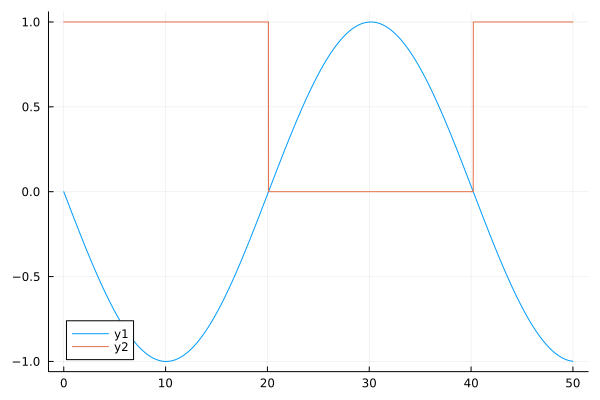

In [246]:
# Check that the polarization and B-field are switching how we want it to
ts = 0:0.01:50
plot(ts, [cos(RF_frequency * t + π/2) for t ∈ ts])
plot!(ts, [iseven(t ÷ (π/RF_frequency)) for t ∈ ts])

In [247]:
n_states = length(states)
particle = OpticalBlochEquations.Particle()
ψ₀ = zeros(ComplexF64, n_states)
ψ₀[1] = 1.0
H₀ = zeros(ComplexF64, n_states, n_states)

decay_dist = Exponential(1)
extra_p = MutableNamedTuple(
    Zeeman_Hx=Zeeman_x_mat,
    Zeeman_Hy=Zeeman_y_mat,
    Zeeman_Hz=Zeeman_z_mat,
    gradient_z=-8.5e2/k,
    gradient_x=-8.5e2/k/2,
    gradient_y=+8.5e2/k/2, # should be -1 but has wrong sign of Zeeman interaction
    decay_dist=decay_dist,
    time_to_decay=rand(decay_dist),
    n_excited = n_excited
    )

n_excited=length(excited_states)

t_span = (0, 30e-3) ./ (1/Γ);

In [248]:
lasers = initialize_lasers()

dT = 0.1
save_every = 10000
p = schrodinger_stochastic(particle, states, lasers, d, ψ₀, m/(ħ*k^2/Γ), dT, save_every, n_excited;
extra_p=extra_p, λ=λ, Γ=Γ, update_H=update_H)

cb = ContinuousCallback(condition, SE_collapse_pol_always!, nothing, save_positions=(false,false))
prob = ODEProblem(ψ_stochastic!, p.ψ, t_span, p)

# randomize_initial_vector!(prob.p, x_dist, y_dist, z_dist, vx_dist, vy_dist, vz_dist)
fixed_initial_vector!(prob.p, 0e-3, 0e-3, 0e-3, 0, 0.1, 0.0)
random_initial_state!(prob.p)

using Logging: global_logger
using TerminalLoggers: TerminalLogger
global_logger(TerminalLogger())

@time sol = DifferentialEquations.solve(prob, DP5(), reltol=1e-3, callback=cb, saveat=1000, maxiters=10000000, progress=true, progress_steps=200000);

ODE   0%|█                                              |  ETA: N/A
ODE   6%|███                                            |  ETA: 0:00:40
ODE  12%|██████                                         |  ETA: 0:00:38
ODE  18%|█████████                                      |  ETA: 0:00:36
ODE  23%|███████████                                    |  ETA: 0:00:33
ODE  29%|██████████████                                 |  ETA: 0:00:31
ODE  35%|█████████████████                              |  ETA: 0:00:28
ODE  41%|████████████████████                           |  ETA: 0:00:26
ODE  47%|███████████████████████                        |  ETA: 0:00:23
ODE  53%|█████████████████████████                      |  ETA: 0:00:20
ODE  58%|████████████████████████████                   |  ETA: 0:00:18
ODE  64%|███████████████████████████████                |  ETA: 0:00:15
ODE  70%|██████████████████████████████████             |  ETA: 0:00:13
ODE  76%|████████████████████████████████████           |  ETA: 0:00

 46.387252 seconds (4.16 M allocations: 273.522 MiB, 0.25% gc time, 7.66% compilation time)


ODE 100%|███████████████████████████████████████████████| Time: 0:00:42


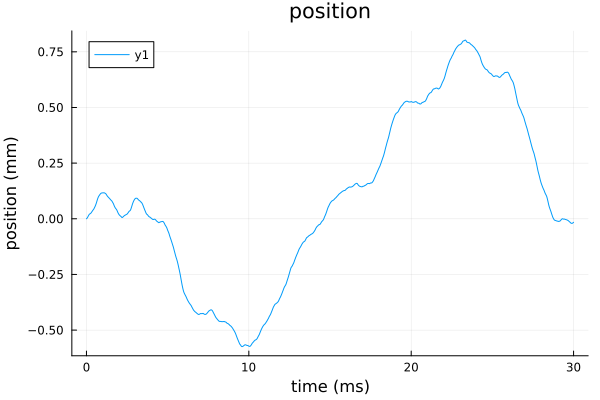

In [249]:
plot_ts = sol.t
plot_us = sol.u

# plot()
# for i in n_states + length(excited_states) +1 :n_states + length(excited_states) + 3
#     plot!(plot_ts/Γ*1e3, [real(u[i]) for u in plot_us]./k*1e3)
# end
# plot!(legend=true, title="position", xlabel="time (ms)",ylabel="position (mm)")

# plot y trajectory
plot()
plot!(plot_ts/Γ*1e3, [real(u[n_states + length(excited_states)+2]) for u in plot_us]./k*1e3)
plot!(legend=true, title="position", xlabel="time (ms)",ylabel="position (mm)")

In [250]:
(p.fields.ω[7] - p.fields.ω[1]) .* (Γ/2π)

-5.213629779815674e7

Final temperature = 1.59e-03 K

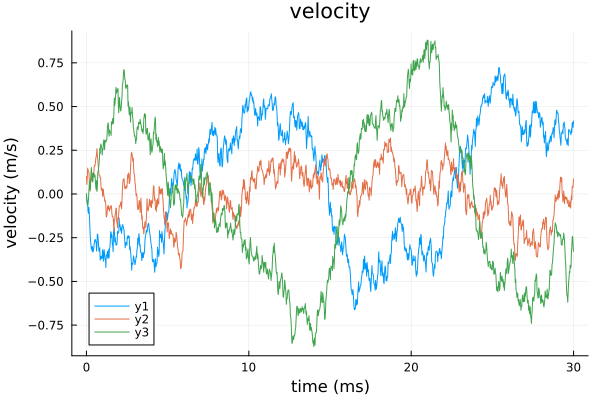

In [251]:
plot()
for i in n_states + length(excited_states) + 4:n_states + length(excited_states) + 6
    plot!(plot_ts/Γ*1e3, [real(u[i]) for u in plot_us]./k*Γ)
end
sol_vz = [real(u[n_states + length(excited_states) + 6]) for u in sol.u].*(Γ/k);
v2 = mean(sol_vz[end-length(sol_vz)÷2:end].^2)
k_B = 1.381e-23
@printf("Final temperature = %.2e K", m*v2/k_B)
plot!(legend=true, title="velocity", xlabel="time (ms)",ylabel="velocity (m/s)")

In [252]:
p.n_scatters

26373

In [253]:
println("Scattering rate:")
p.n_scatters / (sol.t[end] / Γ)

Scattering rate:


879100.0000000001

# Propagating multiple particles

In [285]:
n_values = 80
n_threads=Threads.nthreads()
batch_size = fld(n_values, n_threads)
remainder = n_values - batch_size * n_threads
prog_bar = Progress(n_values)

x_trajectories = Array{Vector{Float64}}(undef, n_values) 
y_trajectories = Array{Vector{Float64}}(undef, n_values) 
z_trajectories = Array{Vector{Float64}}(undef, n_values) 
x_velocities = Array{Vector{Float64}}(undef, n_values) 
y_velocities = Array{Vector{Float64}}(undef, n_values) 
z_velocities = Array{Vector{Float64}}(undef, n_values) 
A_populations = Array{Vector{Float64}}(undef, n_values) 
times = Array{Vector{Float64}}(undef, n_values) 

particle = OpticalBlochEquations.Particle()
ψ₀ = zeros(ComplexF64, length(states))
ψ₀[1] = 1.0

n_excited=length(excited_states)
n_states = length(states)

temp = @with_unit 0.5 "mK"
diameter = @with_unit 0.7 "mm"
displacement = @with_unit 1.9 "mm"
kick = @with_unit 0.8 "m/s"

y_dist, vy_dist = init_isotropic_MOT_distribution(temp, diameter)
z_dist, vz_dist = init_isotropic_MOT_distribution(temp, diameter)
x_dist, vx_dist = init_MOT_distribution(temp, diameter, displacement, kick)

plot(legend=false, title="position", xlabel="time (ms)", ylabel="position (mm)")

Threads.@threads for i ∈ 1:n_threads
    cb_copy = deepcopy(cb)
    extra_p_copy = deepcopy(extra_p)
    
    _batch_size = i <= remainder ? (batch_size + 1) : batch_size
    batch_start_idx = 1 + (i <= remainder ? (i - 1) : remainder) + batch_size * (i-1)
    
    for j ∈ batch_start_idx:(batch_start_idx + _batch_size - 1)
        
        particle = OpticalBlochEquations.Particle()
        lasers = initialize_lasers()
        
        p = schrodinger_stochastic(
            particle, states, lasers, d, ψ₀, m/(ħ*k^2/Γ), dT, save_every, n_excited;
            extra_p=extra_p_copy, λ=λ, Γ=Γ, update_H=update_H
        )
        
        prob_copy = ODEProblem(ψ_stochastic!, p.ψ, t_span, p)
        cb_copy = ContinuousCallback(condition, SE_collapse_pol_always!, nothing, save_positions=(false,false))
        
        randomize_initial_vector!(prob_copy.p, x_dist, y_dist, z_dist, vx_dist, vy_dist, vz_dist)
        # fixed_initial_vector!(prob_copy.p, 0.6e-3, 0.6e-3, 0.6e-3, 0, 0, 0)
        random_initial_state!(prob_copy.p)
        
        sol = DifferentialEquations.solve(prob_copy, alg=DP5(), reltol=1e-3, callback=cb_copy, saveat=10000, maxiters=10000000)
        
        x_trajectories[j] =  [real(u[n_states + length(excited_states) + 1]) for u in sol.u]./k*1e3
        y_trajectories[j] = [real(u[n_states + length(excited_states) + 2]) for u in sol.u]./k*1e3
        z_trajectories[j] = [real(u[n_states + length(excited_states) + 3]) for u in sol.u]./k*1e3
        x_velocities[j] = [real(u[n_states + length(excited_states) + 4]) for u in sol.u]./k*Γ
        y_velocities[j] = [real(u[n_states + length(excited_states) + 5]) for u in sol.u]./k*Γ
        z_velocities[j] = [real(u[n_states + length(excited_states) + 6]) for u in sol.u]./k*Γ
        times[j] = sol.t./Γ*1e3
        A_populations[j] = [sum(real.(norm.(u[n_states - n_excited + 1 : n_states]).^2)) for u in sol.u]

        next!(prog_bar)
    end
end

Progress: 100%|█████████████████████████████████████████| Time: 0:04:33


In [286]:
function survived(t_end, times, trajectories)
    _survived = Int64[]
    for i ∈ eachindex(trajectories)
        if times[i][end] * 1e-3 ≈ t_end
            push!(_survived, i)
        end
    end
    return _survived
end

function cloud_size(trajectories, i)
    std(trajectory[i] for trajectory ∈ trajectories)
end

"""
    Evaluates the density given a set of trajectories.
"""
function density(t_end, times, x_trajectories, y_trajectories, z_trajectories)
    _survived = survived(t_end, times, x_trajectories)
    surviving_x_trajectories = x_trajectories[_survived]
    surviving_y_trajectories = y_trajectories[_survived]
    surviving_z_trajectories = z_trajectories[_survived]
    
    n = length(_survived)
    _density = Float64(n)
    if n > 0
        idx_end = length(surviving_x_trajectories[1])
        σ_x = cloud_size(surviving_x_trajectories, idx_end)
        σ_y = cloud_size(surviving_y_trajectories, idx_end)
        σ_z = cloud_size(surviving_z_trajectories, idx_end)
        println(σ_x)
        println(σ_y)
        println(σ_z)
        _density /= σ_x * σ_y * σ_z
    end
    return _density
end

@time density(30e-3, times, x_trajectories, y_trajectories, z_trajectories)

0.8575839725195092
1.1972141677921575
2.2043959405595284
  0.063240 seconds (33.77 k allocations: 2.278 MiB, 99.57% compilation time)


35.34694473929689

## Trajectories

In [287]:
trapped_indicies = []
for j in eachindex(y_trajectories)
    if sqrt(x_trajectories[j][end]^2 + y_trajectories[j][end]^2 + z_trajectories[j][end]^2) <= 20 #mm
       push!(trapped_indicies, j) 
    end
end

max_idx = maximum([length(time) for time ∈ times])

@printf("Number molecules trapped: %i out of %i", length(trapped_indicies), n_values)

Number molecules trapped: 80 out of 80

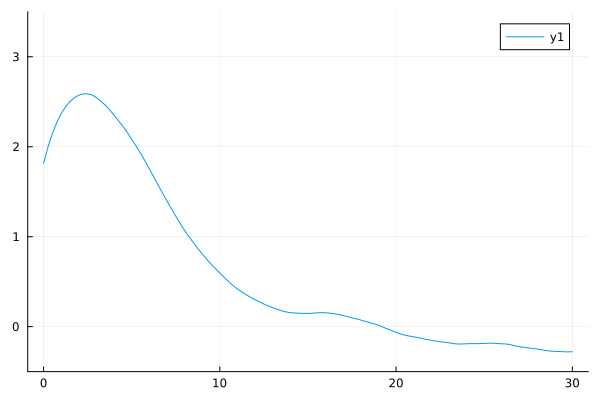

In [289]:
mean_x_trajectory = mean(x_trajectories)
plot(times[1], mean_x_trajectory, ylim=(-0.5,3.5))

In [281]:
using Serialization
results = (
    x_trajectories,
    y_trajectories,
    z_trajectories,
    x_velocities,
    y_velocities,
    z_velocities,
    A_populations,
    times
)
serialize("CaOH_scan//CaOH_redMOT_data//1.2mW.jl", results)
# serialize("CaOH_scan//CaOH_redMOT_data//3mW.jl", results)
# serialize("CaOH_scan//CaOH_redMOT_data//11.5mW.jl", results)
;

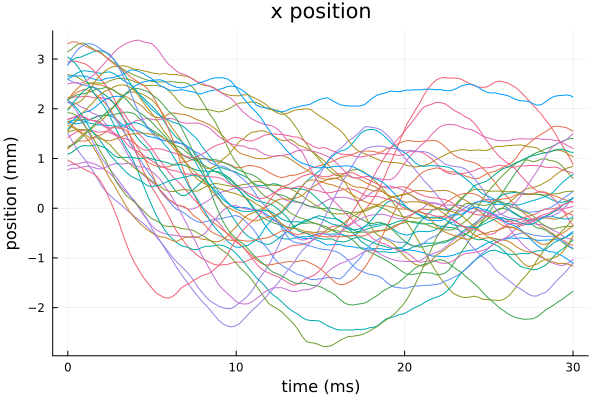

In [268]:
plot(legend=false, title="x position", xlabel="time (ms)",ylabel="position (mm)")
for j in 1:length(x_trajectories)
   plot!(times[j], x_trajectories[j])
end
plot!()

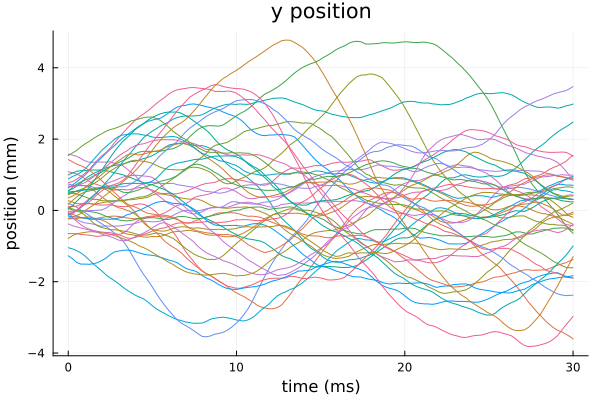

In [269]:
plot(legend=false, title="y position", xlabel="time (ms)",ylabel="position (mm)")
for j in 1:length(y_trajectories)
   plot!(times[j], y_trajectories[j])
end
plot!()

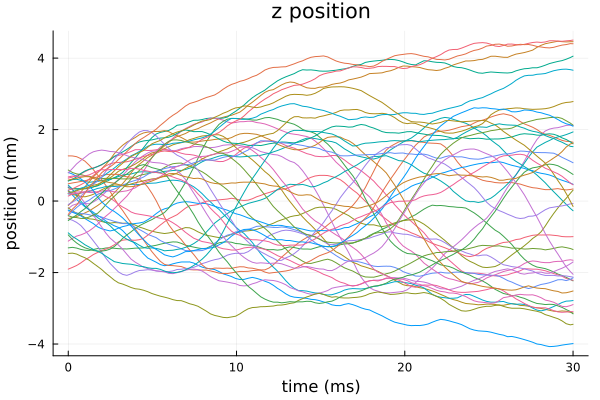

In [270]:
plot(legend=false, title="z position", xlabel="time (ms)",ylabel="position (mm)")
for j in 1:length(z_trajectories)
   plot!(times[j], z_trajectories[j])
end
plot!()

## Motion of the centre of the cloud

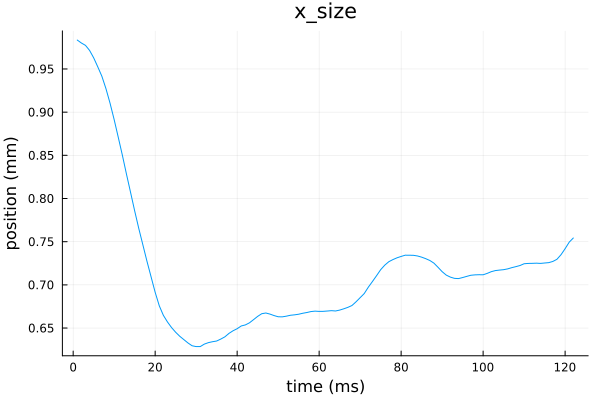

In [1517]:
plot(legend=false, title="x_size", xlabel="time (ms)",ylabel="position (mm)")
σ_x = Float64[]

for i in 1:max_idx
   push!(σ_x, cloud_size(x_trajectories, i))
end
plot!(σ_x)

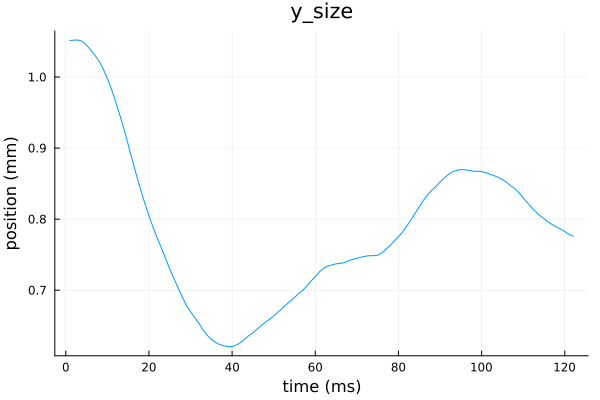

In [1518]:
plot(legend=false, title="y_size", xlabel="time (ms)",ylabel="position (mm)")
σ_y = Float64[]

for i in 1:max_idx
   push!(σ_y, cloud_size(y_trajectories, i))
end
plot!(σ_y)

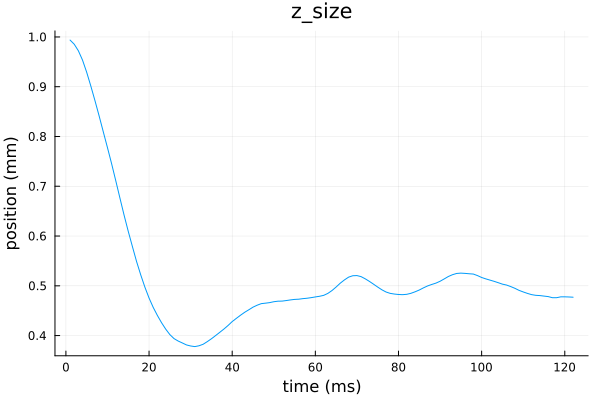

In [1519]:
plot(legend=false, title="z_size", xlabel="time (ms)",ylabel="position (mm)")
σ_z = Float64[]

for i in 1:max_idx
   push!(σ_z, cloud_size(z_trajectories, i))
end
plot!(σ_z)

Final temperature = 2.30e-04 K

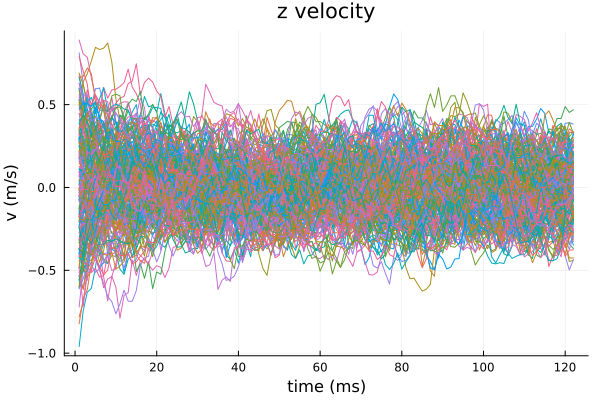

In [1520]:
plot(legend=false, title="z velocity", xlabel="time (ms)",ylabel="v (m/s)")
v_end = Float64[]
for j in trapped_indicies
   plot!(z_velocities[j]) 
    push!(v_end, z_velocities[j][end])

end

v2 = std(v_end)^2

k_B = 1.381e-23
@printf("Final temperature = %.2e K", m*v2/k_B)
plot!()

Final temperature = 2.12e-04 K

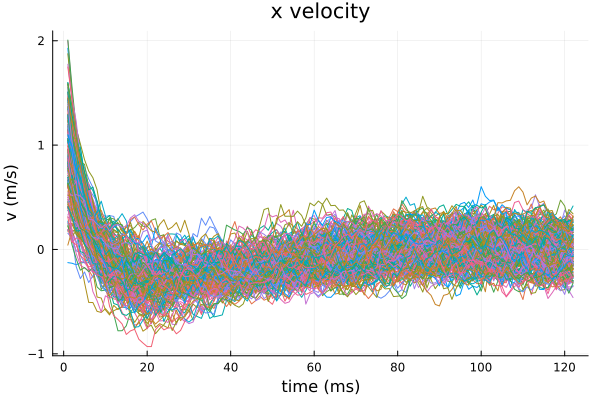

In [1521]:
plot(legend=false, title="x velocity", xlabel="time (ms)",ylabel="v (m/s)")
v_end = Float64[]
for j in trapped_indicies
   plot!(x_velocities[j]) 
    push!(v_end, x_velocities[j][end])
end

v2 = std(v_end)^2

k_B = 1.381e-23
@printf("Final temperature = %.2e K", m*v2/k_B)
plot!()

Final temperature = 2.72e-04 K

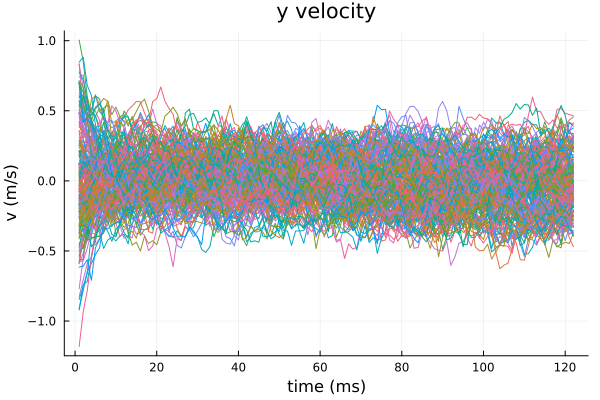

In [1522]:
plot(legend=false, title="y velocity", xlabel="time (ms)",ylabel="v (m/s)")
v_end = Float64[]
for j in trapped_indicies
   plot!(y_velocities[j]) 
    push!(v_end, y_velocities[j][end])
end

v2 = std(v_end)^2

k_B = 1.381e-23
@printf("Final temperature = %.2e K", m*v2/k_B)
plot!()

In [1523]:
function scattering_rate(populations, i)
    _scattering_rate = 0.0
    counts = 0
    for j ∈ 1:n_values
        if length(populations[j]) >= i
            _scattering_rate += populations[j][i] * Γ
            counts += 1
        end
    end
    return _scattering_rate / counts
end;

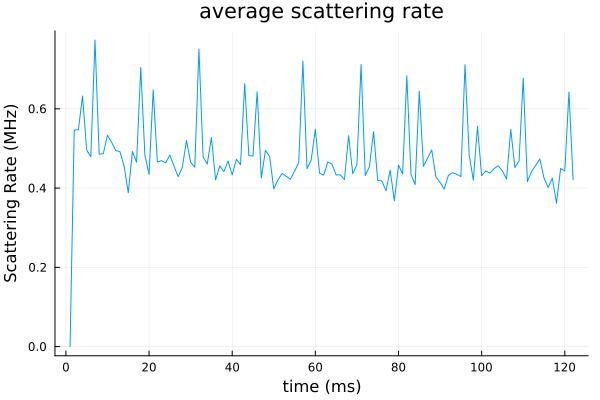

In [1524]:
plot(legend=false, title="average scattering rate", xlabel="time (ms)",ylabel="Scattering Rate (MHz)")
avg_scattering = Float64[]

for i in 1:max_idx
   push!(avg_scattering, scattering_rate(A_populations, i))
end
plot!(1:max_idx, avg_scattering * 1e-6)

In [1525]:
plot(legend=false, title="velocity", xlabel="time (ms)",ylabel="temperature (μK)")
σ_v = []
for i in 1:1000
   push!(σ_v, std([v[i] for v in x_velocities]))
end
plot!(times[1][1:1000], m*σ_v.^2/k_B*1e6)

LoadError: BoundsError: attempt to access 122-element Vector{Float64} at index [123]

In [1526]:
equilibrium_velocities = zeros(Float64,0)
for v_particle in x_velocities
   equilibrium_velocities = [equilibrium_velocities; v_particle[end - length(times[1])÷2: end]] 
end

v2 = std(equilibrium_velocities)^2

k_B = 1.381e-23
@printf("Final temperature = %.2e K", m*v2/k_B)
;

Final temperature = 2.13e-04 K

Final temperature = 2.54e-04 K

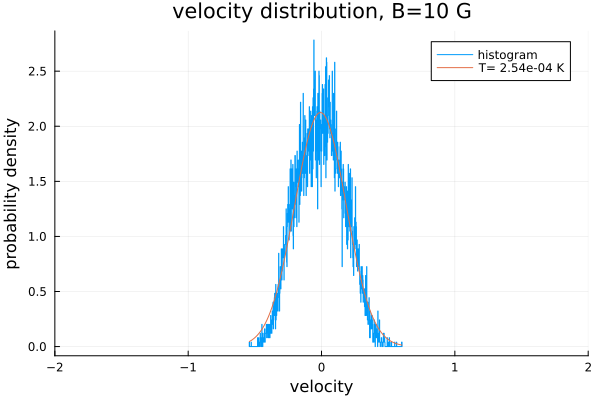

In [1527]:
plot(legend=true, xlabel="velocity", ylabel="probability density", title="velocity distribution, B=10 G")
v2 = std(equilibrium_velocities)^2


x = stephist!(equilibrium_velocities, normalize=:pdf, label="histogram", nbins=1000)

hist_data = fit(Histogram, equilibrium_velocities, nbins=1000)
hist_data.isdensity = true
v = collect(hist_data.edges[1])
dv = v[2]-v[1]
v = v[1:end-1] .+ dv/2
fv = hist_data.weights ./ (sum(hist_data.weights) * dv)

v_fit = curve_fit(Gaussian, v, fv, [0.01, 0, 50])
σ, x0, A = v_fit.param

k_B = 1.381e-23
fit_T = m*σ^2/k_B
@printf("Final temperature = %.2e K", fit_T)

plot!(v, Gaussian(v, v_fit.param), label=@sprintf("T= %.2e K", fit_T))
plot!(xlim=(-2.0,2.0))

Final temperature = 1.71e-03 K

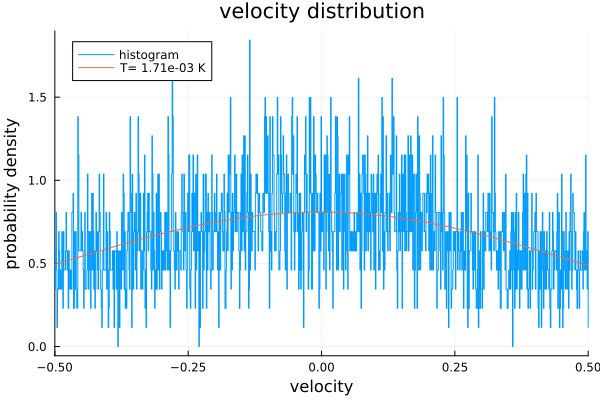

In [1159]:
plot(legend=true, xlabel="velocity", ylabel="probability density", title="velocity distribution")
v2 = std(equilibrium_velocities)^2


x = stephist!(equilibrium_velocities, normalize=:pdf, label="histogram", nbins=4000)

hist_data = fit(Histogram, equilibrium_velocities, nbins=4000)
hist_data.isdensity = true
v = collect(hist_data.edges[1])
dv = v[2]-v[1]
v = v[1:end-1] .+ dv/2
fv = hist_data.weights ./ (sum(hist_data.weights) * dv)

v_fit = curve_fit(Gaussian, v, fv, [0.01, 0, 50])
σ, x0, A = v_fit.param

k_B = 1.381e-23
fit_T = m*σ^2/k_B
@printf("Final temperature = %.2e K", fit_T)

plot!(v, Gaussian(v, v_fit.param), label=@sprintf("T= %.2e K", fit_T))
plot!(xlim=(-0.5,0.5))

Final temperature = 5.35e-07 K

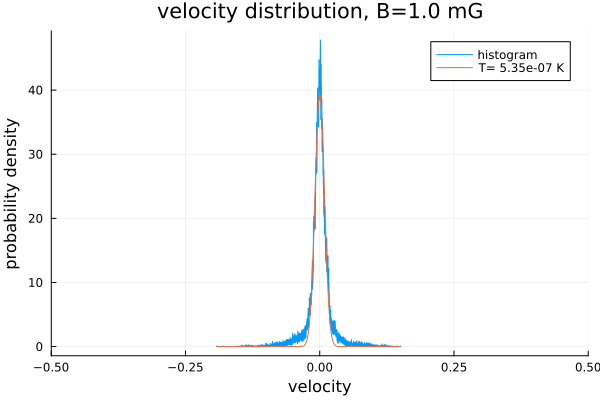

In [1110]:
plot(legend=true, xlabel="velocity", ylabel="probability density", title="velocity distribution, B=1.0 mG", xlim=[-1,1])
v2 = std(equilibrium_velocities)^2


x = stephist!(equilibrium_velocities, normalize=:pdf, label="histogram", nbins=4000)

hist_data = fit(Histogram, equilibrium_velocities, nbins=4000)
hist_data.isdensity = true
v = collect(hist_data.edges[1])
dv = v[2]-v[1]
v = v[1:end-1] .+ dv/2
fv = hist_data.weights ./ (sum(hist_data.weights) * dv)

v_fit = curve_fit(Gaussian, v, fv, [0.01, 0, 50])
σ, x0, A = v_fit.param

k_B = 1.381e-23
fit_T = m*σ^2/k_B
@printf("Final temperature = %.2e K", fit_T)

plot!(v, Gaussian(v, v_fit.param), label=@sprintf("T= %.2e K", fit_T))
plot!(xlim=(-0.5,0.5))

Final temperature = 5.35e-07 K

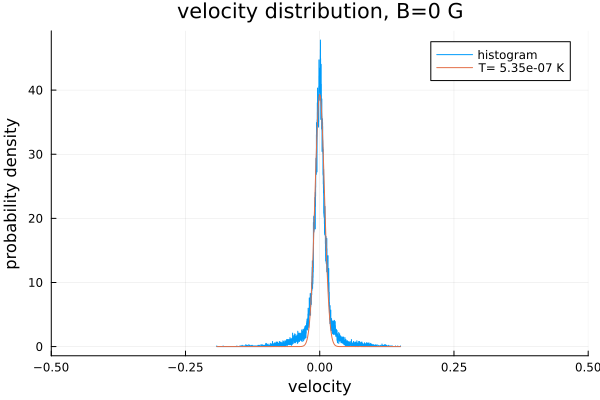

In [1111]:
plot(legend=true, xlabel="velocity", ylabel="probability density", title="velocity distribution, B=0 G")
v2 = std(equilibrium_velocities)^2


x = stephist!(equilibrium_velocities, normalize=:pdf, label="histogram", nbins=4000)

hist_data = fit(Histogram, equilibrium_velocities, nbins=4000)
hist_data.isdensity = true
v = collect(hist_data.edges[1])
dv = v[2]-v[1]
v = v[1:end-1] .+ dv/2
fv = hist_data.weights ./ (sum(hist_data.weights) * dv)

v_fit = curve_fit(Gaussian, v, fv, [0.01, 0, 50])
σ, x0, A = v_fit.param

k_B = 1.381e-23
fit_T = m*σ^2/k_B
@printf("Final temperature = %.2e K", fit_T)

plot!(v, Gaussian(v, v_fit.param), label=@sprintf("T= %.2e K", fit_T))
plot!(xlim=(-0.5,0.5))

Final temperature = 2.79e-05 K

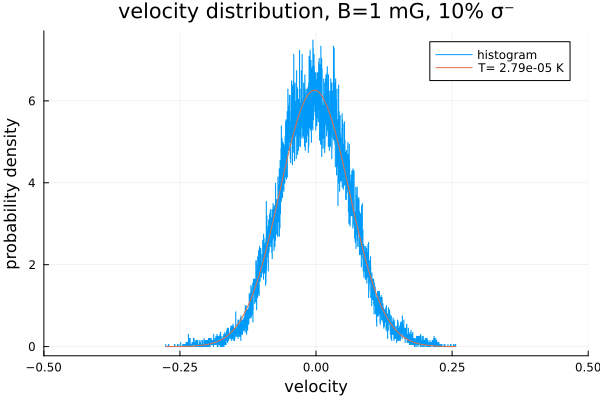

In [1034]:
plot(legend=true, xlabel="velocity", ylabel="probability density", title="velocity distribution, B=1 mG, 10% σ⁻")
v2 = std(equilibrium_velocities)^2


x = stephist!(equilibrium_velocities, normalize=:pdf, label="histogram", nbins=4000)

hist_data = fit(Histogram, equilibrium_velocities, nbins=4000)
hist_data.isdensity = true
v = collect(hist_data.edges[1])
dv = v[2]-v[1]
v = v[1:end-1] .+ dv/2
fv = hist_data.weights ./ (sum(hist_data.weights) * dv)

v_fit = curve_fit(Gaussian, v, fv, [0.01, 0, 50])
σ, x0, A = v_fit.param

k_B = 1.381e-23
fit_T = m*σ^2/k_B
@printf("Final temperature = %.2e K", fit_T)

plot!(v, Gaussian(v, v_fit.param), label=@sprintf("T= %.2e K", fit_T))
plot!(xlim=(-0.5,0.5))

Final temperature = 3.36e-07 K

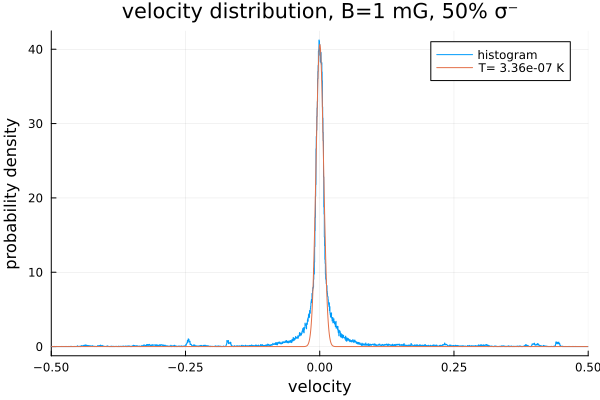

In [609]:
plot(legend=true, xlabel="velocity", ylabel="probability density", title="velocity distribution, B=1 mG, 50% σ⁻")
v2 = std(equilibrium_velocities)^2


x = stephist!(equilibrium_velocities, normalize=:pdf, label="histogram", nbins=4000)

hist_data = fit(Histogram, equilibrium_velocities, nbins=4000)
hist_data.isdensity = true
v = collect(hist_data.edges[1])
dv = v[2]-v[1]
v = v[1:end-1] .+ dv/2
fv = hist_data.weights ./ (sum(hist_data.weights) * dv)

v_fit = curve_fit(Gaussian, v, fv, [0.01, 0, 50])
σ, x0, A = v_fit.param

k_B = 1.381e-23
fit_T = m*σ^2/k_B
@printf("Final temperature = %.2e K", fit_T)

plot!(v, Gaussian(v, v_fit.param), label=@sprintf("T= %.2e K", fit_T))
plot!(xlim=(-0.5,0.5))

# Comparison to Monte Carlo simulations with OBE

  4.025756 seconds (6.19 M allocations: 718.537 MiB, 1.67% gc time, 85.57% compilation time)


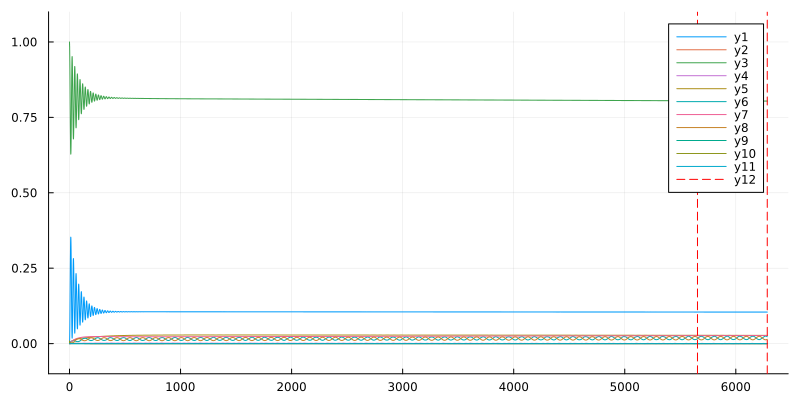

In [172]:
particle = Particle()
ρ0 = zeros(ComplexF64, length(H.states), length(H.states))
ρ0[3,3] = 1.0
freq_res = 1e-2

p = obe(ρ0, particle, H.states, lasers, d, d, true, true, λ, Γ, freq_res, nothing)

t_end = 10p.period
tspan = (0., t_end)
prob = ODEProblem(ρ!, p.ρ0_vec, tspan, p)
callback = PeriodicCallback(reset_force!, prob.p.period)

prob.p.r0 = (0., 0., 0.4) .* 2π
prob.p.v = (0., 0., 0.0)
@time sol = DifferentialEquations.solve(prob, alg=DP5(), reltol=1e-5, abstol = 1e-5, callback=callback)
prob.p.force_last_period .* (ħ * k * Γ / m)*1e-3

using Plots
plot_us = sol.u#[1:10:end]
plot_ts = sol.t#[1:10:end]

n_states = size(p.ρ_soa, 1)
plot(size=(800, 400), ylim=(-0.1, 1.1), legend=nothing)
for i in 1:n_states
    state_idx = n_states*(i-1) + i
    plot!(plot_ts, [real(u[state_idx]) for u in plot_us])
end
plot!(legend=true)
offset = 0
vline!([sol.t[end] - prob.p.period - offset, sol.t[end] - offset], color="red", linestyle=:dash)

In [29]:


function prob_func!(prob, scan_params, i)
    p = prob.p
    
    # Update velocity and position
    p.particle.v .= scan_params[i].v
    p.particle.r0 .= scan_params[i].r
    
    
    # Update magnetic field
    H = p.extra_p.H
    H.parameters.B_z = scan_params[i].B
    evaluate!(H)
    QuantumStates.solve!(H)
    
    # Update transition dipole moments
    update_basis_tdms!(H)
    update_tdms!(H)
    new_d = H.tdms
    
    s = p.extra_p.s
    ω1 = p.extra_p.ω1
    
    k̂ = +x̂; ϵ1 = exp(im*scan_params[i].θx) *rotate_pol(σ⁺, k̂); ϵ_func1 = ϵ_(ϵ1); laser1 = Field(k̂, ϵ_func1, ω1, s)
    k̂ = -x̂; ϵ2 = exp(im*scan_params[i].θx) *rotate_pol(σ⁺, k̂); ϵ_func2 = ϵ_(ϵ2); laser2 = Field(k̂, ϵ_func2, ω1, s)

    k̂ = +ŷ; ϵ3 = exp(im*scan_params[i].θy) * rotate_pol(σ⁺, k̂); ϵ_func3 = ϵ_(ϵ3); laser3 = Field(k̂, ϵ_func3, ω1, s)
    k̂ = -ŷ; ϵ4 = exp(im*scan_params[i].θy) *rotate_pol(σ⁺, k̂); ϵ_func4 = ϵ_(ϵ4); laser4 = Field(k̂, ϵ_func4, ω1, s)

    k̂ = +ẑ; ϵ5 = rotate_pol(σ⁺, k̂);  ϵ_func5 = ϵ_(ϵ5); laser5 = Field(k̂, ϵ_func5, ω1, s)
    k̂ = -ẑ; ϵ6 = rotate_pol(σ⁺, k̂);  ϵ_func6 = ϵ_(ϵ6); laser6 = Field(k̂, ϵ_func6, ω1, s)

    lasers = [laser1, laser2, laser3, laser4, laser5, laser6]
    new_p = obe(p.ρ0, p.particle, H.states, lasers, new_d, nothing, true, true, p.λ, p.Γ, p.freq_res, p.extra_p)
    
    
    return remake(prob, p=new_p)
end

function output_func(p, sol)
    f = p.force_last_period
    return f
end
;

In [584]:
ρ0 = zeros(ComplexF64, length(H.states), length(H.states))
ρ0[3,3] = 1.0

t_end = 10p.period
tspan = (0., t_end)

using RectiGrids

freq_res = 1e-2
extra_p = (H=H, lasers=lasers, ω1 = ω1, s = s)
p = obe(ρ0, particle, H.states, lasers, d, d, true, true, λ, Γ, freq_res, extra_p)

t_end = 10p.period+1; tspan = (0., t_end)
prob = ODEProblem(ρ!, p.ρ0_vec, tspan, p, reltol=1e-3, save_on=false)

di = 5
rs = vcat([(n1*λ/(di+1), n2*λ/(di+1), n3*λ/(di+1)) .* 2π for n1 ∈ 0:di, n2 ∈ 0:di, n3 ∈ 0:di]...)
vzs = LinRange(0,15/(Γ/k),100)
vs = []
for vz in vzs
    push!(vs, [0,0,vz])
end

# vs = [sample_direction(0.0) for _ in 1:1]


scan_values = (B = [0.0], r = rs, v = vs, θx = [0.0], θy = [0.0])
scan_values_grid = RectiGrids.grid(scan_values)

@time forces, populations = force_scan_v2(prob, scan_values_grid, prob_func!, output_func);

averaged_forces = []
averaged_A_populations = []
@time for (i,vz) ∈ enumerate(vzs)
    idxs = [j for (j,x) ∈ enumerate(scan_values_grid) if x.v[3] == vz]
    push!(averaged_forces, mean([f[3] for f in forces[idxs]]))
    push!(averaged_A_populations, mean(populations[idxs, 4:6])*3)
end

LoadError: UndefVarError: `H` not defined

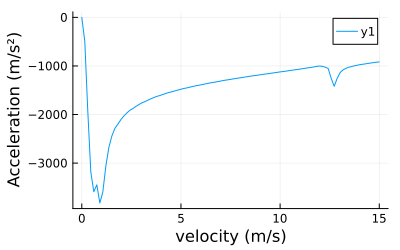

In [175]:
plot(xlabel="velocity (m/s)", ylabel="Acceleration (m/s²)",size=(400,250))
plot!(vzs.*(Γ/k), averaged_forces.* (ħ * k * Γ / m))

In [176]:
# plot(vzs.*(Γ/k), averaged_A_populations,size=(400,250))

In [177]:
include("G:\\My Drive\\github\\BlueDetunedMOTSimulations\\CaOH_simulation_toolbox.jl");
using Interpolations, BeamPropagation
;

In [178]:
scan_values = Dict{String, Vector{Float64}}("B"=>[-1000,1000], "v"=>vzs)
acceleration = zeros(2,length(averaged_forces))
A_populations = zeros(2,length(averaged_forces))

acceleration[1,:] = acceleration[2,:] = averaged_forces.*(ħ * k * Γ / m)
A_populations[1,:] = A_populations[2,:] = averaged_A_populations

acceleration_grids = make_grids(scan_values, acceleration)
A_population_grids = make_grids(scan_values, A_populations)



# Interpolate (in SI units)
B_range = range(scan_values["B"][1],scan_values["B"][end], length=length(scan_values["B"]))
v_range = range(scan_values["v"][1]* (Γ / k),scan_values["v"][end]* (Γ / k), length=length(scan_values["v"]))
        

nodes = (scan_values["B"], scan_values["v"].* (Γ / k))
acceleration_func = interpolate(nodes, acceleration_grids, Gridded(Linear()))
A_population_func = interpolate(nodes, A_population_grids, Gridded(Linear()))     
A_population_func = extrapolate(A_population_func, Flat());


["B", "v"]
["B", "v"]


In [179]:
# y = scan_values["v"].* (Γ / k)
# B_fixed = 1
# plot(xlabel="velocity (m/s)", ylabel="Acceleration (m/s²)",size=(400,250))
# plot!(y, acceleration_func(-100,y) , label=@sprintf("B = %.1f G", B_fixed) )
# plot!()

In [57]:
function update(particles, p, s, dt, time, idx)
    hbar = 1.05457182e-34 
    for i in 1:size(particles, 1)
        B = particles.r[i][3] * p.B_gradient
        v = particles.v[i]
        Pe = p.A_population_func(B * sign(v[3]), abs(v[3]))
        scattering_prob = dt * Γ * Pe
        if rand() < scattering_prob 
            v_rand = sample_direction(hbar * k / m) * 1
            particles.v[i] += SVector(0,0,v_rand[3])
            # if rand() < 0.5
            #     particles.v[i] += sample_direction(hbar * k / m) # SVector(0,0,hbar * k / m)
            # else
            #     particles.v[i] -= SVector(0,0,hbar * k / m)
            # end
        end
    end
    return nothing
end

function init_1D_MOT_distribution(T, diameter)
    kB = 1.381e-23
    m = @with_unit 57 "u"
    σ = sqrt(kB * T / m)
    
    r = (Normal(0, diameter), Normal(0, diameter), Normal(0, diameter))
    v = (Normal(0, σ), Normal(0, σ), Normal(0, σ))
    a = (Normal(0, 0), Normal(0, 0), Normal(0, 0))
    return r, v, a
end

function init_isotropic_MOT_distribution(T, diameter)
    kB = 1.381e-23
    m = @with_unit 57 "u"
    σ = sqrt(kB * T / m)
    
    r = Normal(0, diameter)
    v = Normal(0, σ)
    return r, v
end


function discard_particles!(particles, discard)
    @inbounds for i in 1:size(particles, 1)
        particles.dead[i] = discard(particles.r[i], particles.v[i])
    end
    StructArrays.foreachfield(x -> deleteat!(x, particles.dead), particles)
    return nothing
end

function discard_out_of_bound(r, v)
    if abs(r[3]) > abs( maximum(scan_values["B"]) / B_gradient )
        return true
    elseif abs(v[3]) > abs( maximum(scan_values["v"])* (Γ / k))
        return true
    else
        return false
    end
end

discard_out_of_bound (generic function with 1 method)

In [181]:
import BeamPropagation.Particle
import StructArrays: StructArray, StructVector
using StructArrays

B_gradient = 0
n = 1000
save_every = 3000
delete_every = 100
dt_min = 1e-10
dt_max = 1e-4
abstol = 1e-5
dt = 1e-8
total_time = @with_unit 5 "ms"
max_steps = Int64(ceil(total_time / dt))
alg = "rkf12"
use_adaptive = false
dt0 = 1e-5
times = (0:dt:max_steps * dt)[1:save_every:end-1]


particles = StructArray{BeamPropagation.Particle}(undef, n)
trajectories = [SVector{3, Float64}[] for _ ∈ 1:length(particles)]
velocities = [SVector{3, Float64}[] for _ ∈ 1:length(particles)]
A_populations = [SVector{1, Float64}[] for _ ∈ 1:length(particles)]

temp = @with_unit 1 "mK"
diameter = @with_unit 0.6 "mm"
r, v, a = init_1D_MOT_distribution(temp, diameter)



p = MutableNamedTuple(B_gradient=B_gradient, acceleration_func=acceleration_func, A_population_func = A_population_func)
mc_s = MutableNamedTuple(trajectories=trajectories, velocities = velocities, A_populations = A_populations)

@time propagate_particles!(r, v, a, 
    alg, particles, f, save, discard_out_of_bound, save_every, delete_every, max_steps, update, p, mc_s, dt, use_adaptive, 
    dt_min, dt_max, abstol, true
)



Progress: 100%|█████████████████████████████████████████| Time: 0:00:0439mProgress:   0%|█                                        |  ETA: 30.02 days


  4.219141 seconds (42.01 M allocations: 726.699 MiB, 367.81% compilation time)


Final temperature = 9.05e-05 K

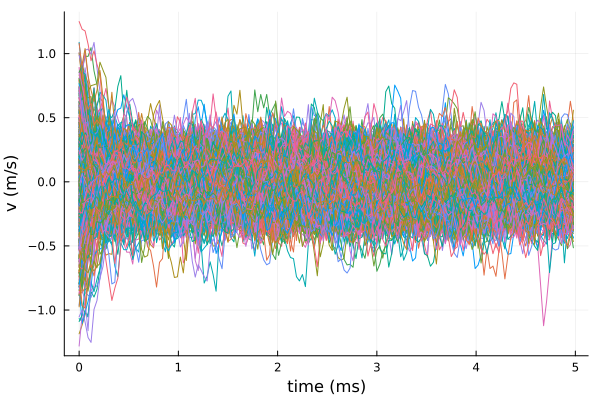

In [182]:
plot(xlabel="time (ms)", ylabel="v (m/s)", legend=false)
for particle_id in 1:1:n
    particle_z_velocity = [mc_s.velocities[particle_id][i][3] for i in  eachindex(mc_s.trajectories[particle_id])]
    plot!(times[1:length(particle_z_velocity)] * 1e3, particle_z_velocity)
end

vs = []
i_half = length(times)÷2
for particle_id in 1:1:n
    push!(vs, mc_s.velocities[particle_id][i_half][3])
end
v = std(vs)

k_B = 1.381e-23
@printf("Final temperature = %.2e K", 1/2*m*v^2/k_B)


plot!()

In [60]:
function add_B_to_A!(A::StructArray{<:Complex}, B::StructArray{<:Complex})
    @turbo for i ∈ eachindex(A)
        A.re[i] = A.re[i] + B.re[i]
        A.im[i] = A.im[i] + B.im[i]
    end
end

function add_B_to_A_with_scalar!(A::StructArray{<:Complex}, B::StructArray{<:Complex}, scalar::Float64)
    @turbo for i ∈ eachindex(A)
        A.re[i] = A.re[i] + scalar * B.re[i]
        A.im[i] = A.im[i] + scalar * B.im[i]
    end
end

add_B_to_A_with_scalar! (generic function with 1 method)

### Copies of some private functions from OpticalBlochEquations package

In [18]:
# Multiplication using `@turbo` from LoopVectorization
function mul_turbo!(C, A, B)
    @turbo for m ∈ 1:size(A,1), n ∈ 1:size(B,2)
        Cmn_re = 0.0
        Cmn_im = 0.0
        for k ∈ 1:size(A,2)
            A_mk_re = A.re[m,k]
            A_mk_im = A.im[m,k]
            B_kn_re = B.re[k,n]
            B_kn_im = B.im[k,n]
            Cmn_re += A_mk_re * B_kn_re - A_mk_im * B_kn_im
            Cmn_im += A_mk_re * B_kn_im + A_mk_im * B_kn_re
        end
        C.re[m,n] = Cmn_re
        C.im[m,n] = Cmn_im
    end
end

function mul_by_im!(C::StructArray{<:Complex})
    @turbo for i ∈ eachindex(C)
        a = C.re[i]
        C.re[i] = -C.im[i]
        C.im[i] = a
    end
end

function mul_by_im_minus!(C::StructArray{<:Complex})
    @turbo for i ∈ eachindex(C)
        a = C.re[i]
        C.re[i] = C.im[i]
        C.im[i] = -a
    end
end

function soa_to_base!(ρ::Array{<:Complex}, ρ_soa::StructArray{<:Complex})
    @inbounds for i in eachindex(ρ_soa)
        ρ[i] = ρ_soa.re[i] + im * ρ_soa.im[i]
    end
    return nothing
end

function base_to_soa!(ρ::Array{<:Complex}, ρ_soa::StructArray{<:Complex})
    @inbounds for i in eachindex(ρ_soa)
        ρ_soa.re[i] = real(ρ[i])
        ρ_soa.im[i] = imag(ρ[i])
    end
    return nothing
end

function base_to_soa_vec!(ρ::Array{<:Complex}, ρ_soa::StructArray{<:Complex})
    @inbounds for i in eachindex(ρ, ρ_soa)
        ρ_soa.re[i] = real(ρ[i])
        ρ_soa.im[i] = imag(ρ[i])
    end
    return nothing
end

function update_eiωt!(eiωt::StructArray{<:Complex}, ω::Array{<:Real}, τ::Real)
    @turbo for i ∈ eachindex(ω)
        eiωt.im[i], eiωt.re[i] = sincos( ω[i] * τ )
    end
    return nothing
end



update_eiωt! (generic function with 1 method)

In [25]:
import OpticalBlochEquations.update_H!

function update_H(H, p, τ)
    @turbo for i in eachindex(H)
        H.re[i] = p.H₀.re[i]
        H.im[i] = p.H₀.im[i]
    end
    return nothing
end

function update_H!(p, τ, r, H₀, fields, H, E_k, ds, ds_state1, ds_state2, Js)

    p.update_H(H, p, τ)
    
    # @turbo for i in eachindex(H)
    #     H.re[i] = H₀.re[i]
    #     H.im[i] = H₀.im[i]
    # end
 
    update_fields!(fields, r, τ)

    # Set summed fields to zero
    p.E -= p.E
    @inbounds for i ∈ 1:3
        E_k[i] -= E_k[i]
    end
    
    # Sum updated fields
    @inbounds for i ∈ eachindex(fields)
        E_i = fields.E[i] * sqrt(fields.s[i]) / (2 * √2)
        k_i = fields.k[i]
        p.E += E_i
        for k ∈ 1:3
            E_k[k] += E_i * k_i[k]
        end
    end

    # This can be used to exclude very off-resonant terms, need to add a user-defined setting to determine behavior
    # @inbounds for i ∈ eachindex(fields)
    #     s = fields.s[i]
    #     ω_field = fields.ω[i]
    #     x = sqrt(s) / (2 * √2)
    #     @inbounds for q ∈ 1:3
    #         E_i_q = fields.E[i][q]
    #         if norm(E_i_q) > 1e-10
    #             d_nnz_q = d_nnz[q]
    #             d_q = @view d[:,:,q]
    #             @inbounds @simd for cart_idx ∈ d_nnz_q
    #                 m, n = cart_idx.I
    #                 if abs(ω_field - (ω[n] - ω[m])) < 100 # Do not include very off-resonant terms (terms detuned by >10Γ)
    #                     val = x * E_i_q * d_q[m,n]
    #                     H[m,n] += val
    #                     H[n,m] += conj(val)
    #                 end
    #             end
    #         end
    #     end
    # end

    @inbounds for q ∈ 1:3
        E_q = p.E[q]
        if norm(E_q) > 1e-10
            E_q_re = real(E_q)
            E_q_im = imag(E_q)
            ds_q = ds[q]
            ds_q_re = ds_q.re
            ds_q_im = ds_q.im
            ds_state1_q = ds_state1[q]
            ds_state2_q = ds_state2[q]
            @turbo for i ∈ eachindex(ds_q)
                m = ds_state1_q[i] # excited state
                n = ds_state2_q[i] # ground state
                d_re = ds_q_re[i]
                d_im = ds_q_im[i]
                val_re = E_q_re * d_re - E_q_im * d_im
                val_im = E_q_re * d_im + E_q_im * d_re
                H.re[n,m] += val_re
                H.im[n,m] += val_im
                H.re[m,n] += val_re
                H.im[m,n] -= val_im
            end
        end
    end

    # Is this version faster?
    # @inbounds for q ∈ 1:3
    #     E_q = p.E[q]
    #     if norm(E_q) > 1e-10
    #         d_nnz_q = d_nnz[q]
    #         d_q = @view d[:,:,q]
    #         @inbounds @simd for cart_idx ∈ d_nnz_q
    #             m, n = cart_idx.I
    #             val = E_q * d_q[m,n]
    #             H[m,n] += val
    #             H[n,m] += conj(val)
    #         end
    #     end
    # end

    for J ∈ Js
        rate = im * J.r^2 / 2
        H[J.s, J.s] -= rate
    end

    return nothing
end

round_to_mult(val, prec) = round.(val ./ prec) .* prec

function round_freq(ω, freq_res)
    ω_min = freq_res
    return round_to_mult(ω, ω_min)
end
export round_freq



function round_v_by_norm(v, digits)
    v_norm = norm(v)
    return v ./ (v_norm / round(v_norm, digits=digits))
end

function round_freqs!(states, fields, freq_res)
    """
    Rounds frequencies of state energies and fields by a common denominator.
    
    freq_res::Float: all frequencies are rounded by this value (in units of Γ)
    """
    for i in eachindex(fields)
        fields.ω[i] = round_freq(fields.ω[i], freq_res)
    end
    for i in eachindex(states)
        states.E[i] = round_freq(states.E[i], freq_res)
    end
    return nothing
end


round_freqs! (generic function with 1 method)

In [202]:
F = 1
F′ = 1
J_mat = zeros(2F+1 + 2F′+1,2F+1 + 2F′+1)
for i in 1:2F+1
    M = -F-1+i
    for j in 2F+2:2F+1+2F′+ 1
        M′ = -F′-1+ (j - 2F - 1)
        for p in -1:1:1
            J_mat[i,j] += norm(wigner3j(F, 1, F′, M, -p, -M′))^2
        end
    end
end
J_mat

6×6 Matrix{Float64}:
 0.0  0.0  0.0  0.166667  0.166667  0.0
 0.0  0.0  0.0  0.166667  0.0       0.166667
 0.0  0.0  0.0  0.0       0.166667  0.166667
 0.0  0.0  0.0  0.0       0.0       0.0
 0.0  0.0  0.0  0.0       0.0       0.0
 0.0  0.0  0.0  0.0       0.0       0.0

In [207]:
Ux = [[1/2, -1/sqrt(2), 1/2],
    [-1/sqrt(2),0,1/sqrt(2)],
    [1/2, 1/sqrt(2), 1/2]]

Ux = mapreduce(permutedims, vcat, Ux)

U = zeros(2F+1 + 2F′+1,2F+1 + 2F′+1)

3×3 Matrix{Float64}:
  0.5       -0.707107  0.5
 -0.707107   0.0       0.707107
  0.5        0.707107  0.5